<a href="https://colab.research.google.com/github/setthawut8/ai/blob/main/gan/an_advanced_gan_with_wandb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [49]:
#https://medium.com/@ideami: read more about conv
#https://www.udemy.com/course/generative-creative-ai-from-gans-to-clip-with-python-and-pytorch/learn/lecture/27464978#questions
#import libraries

import torch, torchvision, os, PIL, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def show(tensor, num=25, wanbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1,2,0)

  ## optional: wandb = Weights and Biases
  if (wanbactive==1):
    wandb.log({name: wandb.Image(grid.numpy().clip(0,1))})

  plt.imshow(grid.clip(0,1))
  plt.show()

## hyperparameters and general parameters
n_epochs = 10000
batch_size = 128
lr=1e-4
z_dim=200
device='cuda' #GPU

cur_step=0
crit_cycles=5
gen_losses=[]
crit_losses=[]
show_step=35
save_step=35

wandbact=1 #yes we want to track stats through weights and biases, optional

In [2]:
### optional
!pip install wandb -qqq
import wandb

WANDB_API_KEY = 'f8d1a6a69124ee6c91f192cd12942c0a0dc0bf8c'

## api-key from wandb
wandb.login(key=WANDB_API_KEY)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 50.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 206.5/206.5 kB 29.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.1 MB/s eta 0:00:00


wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [3]:
%%capture
experiment_name = wandb.util.generate_id()

myrun=wandb.init(
    project='wgan',
    group=experiment_name,
    config={
        "optimizer":"adam",
        "model":"wgan gp",
        "epoch":"1000",
        "batch_size":128
    }
)

config=wandb.config

In [4]:
print(experiment_name)

yw2kjct1


In [5]:
#generator model

class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim=z_dim

    self.gen = nn.Sequential(
        ## ConvTranspose2d: in_chahnnels, out_channels, kernel_size,stride, padding
        ## Calculating new width and height: (n-1)*stride - 2*padding +ks
        ## n = width or height
        ## ks = kernel size
        ## we begin with a 1x1 image with z_dim number of channels (200)
        nn.ConvTranspose2d(z_dim, d_dim*32, 4, 1, 0), ## new size = 4x4 (ch: 200, 512)
        nn.BatchNorm2d(d_dim*32),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*32, d_dim*16, 4, 2, 1), ## new size of the image = 8x8 (ch: 512, 256)
        nn.BatchNorm2d(d_dim*16),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*16, d_dim*8, 4, 2, 1), ## the new size = 16x16 (ch: 256, 128)
        nn.BatchNorm2d(d_dim*8),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*8, d_dim*4, 4, 2, 1), ## the new size = 32x32 (ch: 128, 64)
        nn.BatchNorm2d(d_dim*4),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*4, d_dim*2, 4, 2, 1), ## the new size = 64x64 (ch: 64, 32)
        nn.BatchNorm2d(d_dim*2),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*2, 3, 4, 2, 1), ## the new size = 128x128 (ch: 32, 3)
        nn.Tanh() ### produce a result in the range from -1 to 1
    )

  def forward(self, noise):
    x=noise.view(len(noise), self.z_dim, 1, 1) # 128 x 200 x 1 x 1
    return self.gen(x)

def gen_noise(num, z_dim, device='cuda'):
  return torch.rand(num, z_dim, device=device) # 128 x 200

In [28]:
## critic model

class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(    
      # Con2d: in_channels, out_channels, kernel_size, stride=1, padding=0
      ## New width and height: # ((n+2*pad-ks)//stride)+1
      nn.Conv2d(3, d_dim, 4, 2, 1), # ((n+2*pad-ks)//stride)+1 = ((128+2*1-4)//2)+1 = 64x64 (ch: 3, 16)
      nn.InstanceNorm2d(d_dim),
      nn.LeakyReLU(0.2),
      
      nn.Conv2d(d_dim, d_dim*2, 4, 2, 1), ## 32x32 (ch: 16, 32)
      nn.InstanceNorm2d(d_dim*2),
      nn.LeakyReLU(0.2),
      
      nn.Conv2d(d_dim*2, d_dim*4, 4, 2, 1), ## 16x16 (ch: 32, 64)
      nn.InstanceNorm2d(d_dim*4),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*4, d_dim*8, 4, 2, 1), ## 8x8 (ch: 64, 128)
      nn.InstanceNorm2d(d_dim*8),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*8, d_dim*16, 4, 2, 1), ## 4x4 (ch: 128, 256)
      nn.InstanceNorm2d(d_dim*16),
      nn.LeakyReLU(0.2),

      nn.Conv2d(d_dim*16, 1, 4, 1, 0), ## ((n+2*pad-ks)//stride)+1 == ((4+2*0-4)/1)+1 = 1x1 (ch: 256, 1)
    )

  def forward(self, image):
    # image: 128 x 3 x 128 x 128
    crit_pred = self.crit(image) # 128 x 1 x 1 x 1
    return crit_pred.view(len(crit_pred),-1) # 128 x 1

In [8]:
## optional init your weights in different ways
def init_weights(m):
  if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias,0)

  if isinstance(m, nn.BatchNorm2d):
    torch.nn.init.normal_(m.weight, 0.0, 0.02)
    torch.nn.init.constant_(m.bias,0)

In [20]:
import gdown, zipfile

# load dataset
url= 'https://drive.google.com/uc?id=1xrXQMLv-ZMw0SeMl1TabRE60zqhXdsBP'
path = 'data/celeba'
download_path = f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path,'r') as ziphandler:
  ziphandler.extractall(path)

Downloading...
From: https://drive.google.com/uc?id=1xrXQMLv-ZMw0SeMl1TabRE60zqhXdsBP
To: /content/data/celeba/img_align_celeba.zip
100%|██████████| 1.44G/1.44G [00:25<00:00, 56.1MB/s]


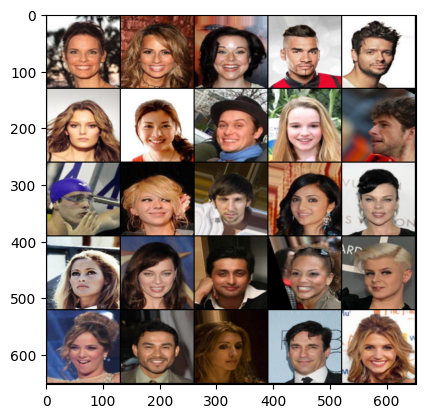

In [30]:
### Dataset, Dataloader, declare gen & crit, test dataset

class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes=[size, size]
    items, labels = [], []

    for data in os.listdir(path)[:lim]:
      #path: './data/celeba/img_align_celeba'
      #data: '114568.jpg'
      item = os.path.join(path, data)
      items.append(item)
      labels.append(data)
    self.items=items
    self.labels=labels

  def __len__(self):
    return len(self.items)

  def __getitem__(self, idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB') #(178, 218)
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data)) # 128 x 128 x 3
    data = np.transpose(data, (2, 0, 1)).astype(np.float32, copy=False) # 3 x 128 x 128 # images from 0 to 255
    data = torch.from_numpy(data).div(255) # 0 to 1
    return data, self.labels[idx]

## Dataset 
data_path='./data/celeba/img_align_celeba'
ds = Dataset(data_path, size=128, lim=10000)

## Dataloader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

## Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

## Optimizers
gen_opt = torch.optim.Adam(gen.parameters(),lr=lr, betas=(0.5, 0.9))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5,0.9))

## Initialiazation
## gen=gen.apply(init_weights)
## crit=crit.apply(init_weights)

# wandb [optional]
if (wandbact==1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x,y = next(iter(dataloader))
show(x)

In [43]:
## gradient penalty calculation

def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128 x 3 x 128 x 128
  mix_scores = crit(mix_images) # 128 x 1

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs = torch.ones_like(mix_scores),
      retain_graph=True,
      create_graph=True,
  )[0] # 128 x 3 x 128 x 128

  gradient = gradient.view(len(gradient), -1) #128 x49152
  gradient_norm = gradient.norm(2, dim=1) 
  gp = gamma * ((gradient_norm-1)**2).mean()

  return gp

In [35]:
## Save and load checkpoints

root_path = './data/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict(),
  }, f"{root_path}G-{name}.pkl")

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict(),
  }, f"{root_path}C-{name}.pkl")
    
  print("Saved checkpoint")
    
def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded checkpoint")

In [37]:
#testing the checkpoint funciton
epoch=1
save_checkpoint("test")
load_checkpoint("test")

Saved checkpoint
Loaded checkpoint


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  35 35
Saved checkpoint


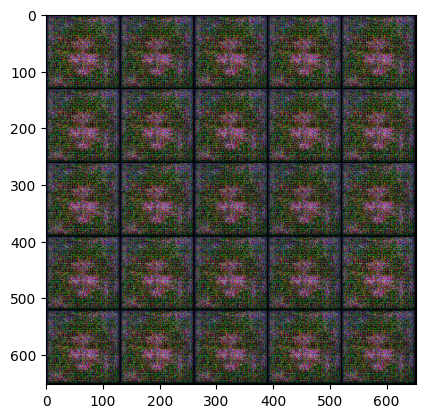

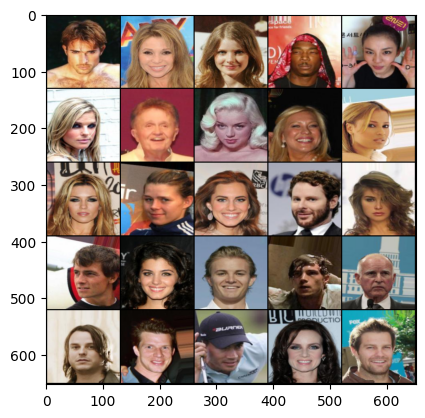

Epoch: 0: Step 35: Generator loss: 39.18667373657227, critic loss: -41.25164618355887


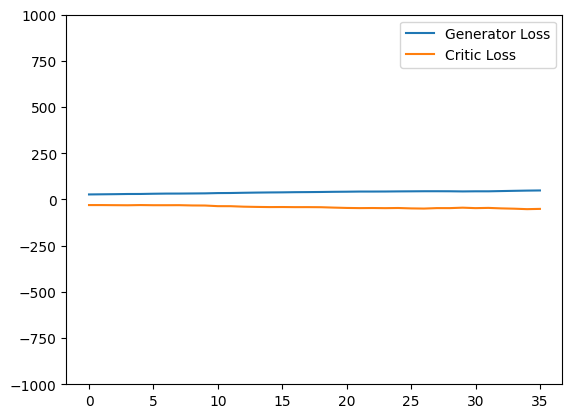

Saving checkpoin:  70 35
Saved checkpoint


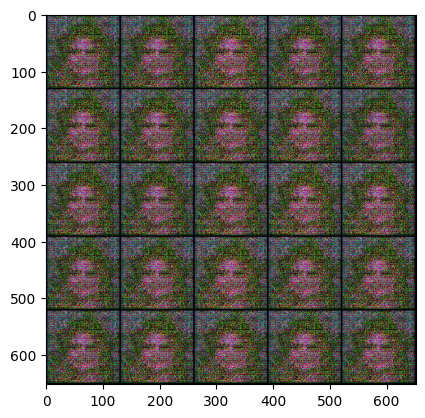

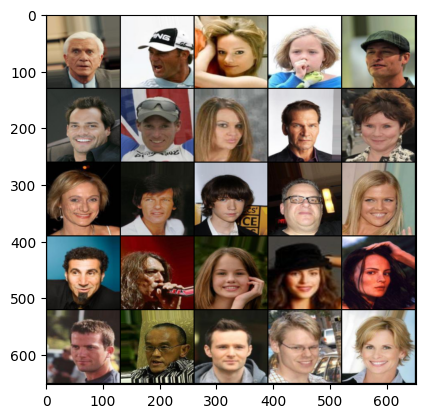

Epoch: 0: Step 70: Generator loss: 55.59441713605608, critic loss: -54.816835632324214


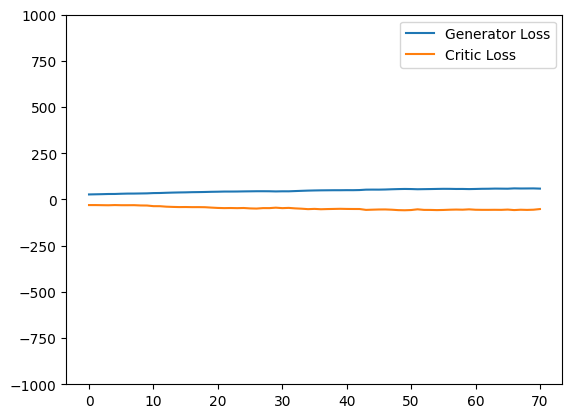

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  105 35
Saved checkpoint


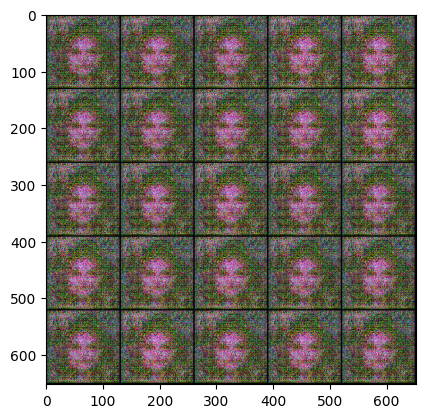

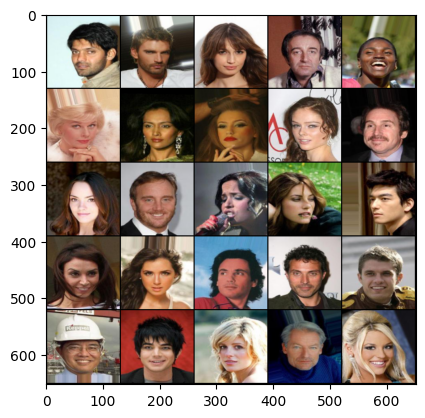

Epoch: 1: Step 105: Generator loss: 59.91642183576312, critic loss: -53.672374877929684


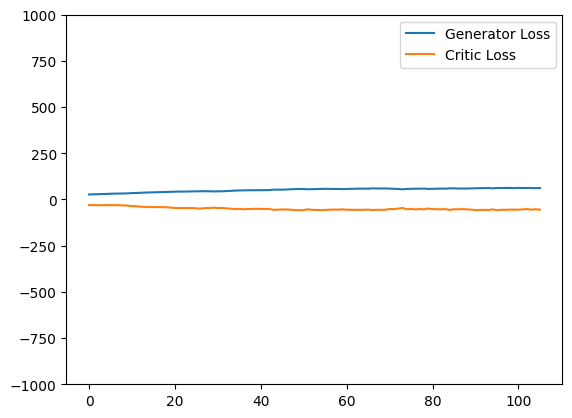

Saving checkpoin:  140 35
Saved checkpoint


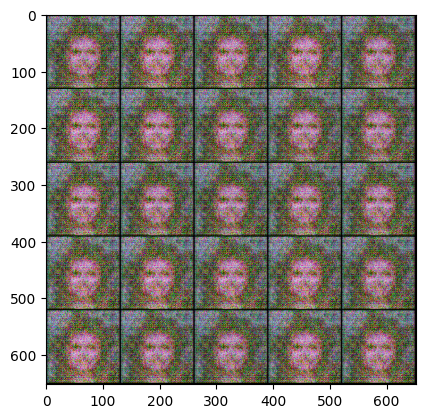

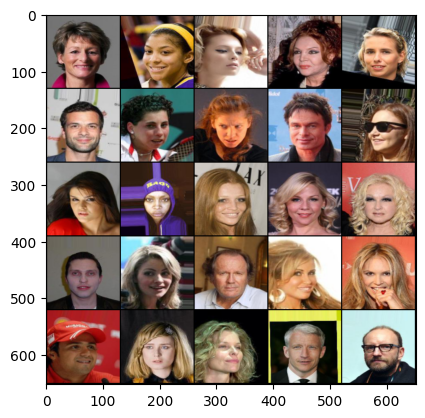

Epoch: 1: Step 140: Generator loss: 69.17325537545341, critic loss: -61.412451324462886


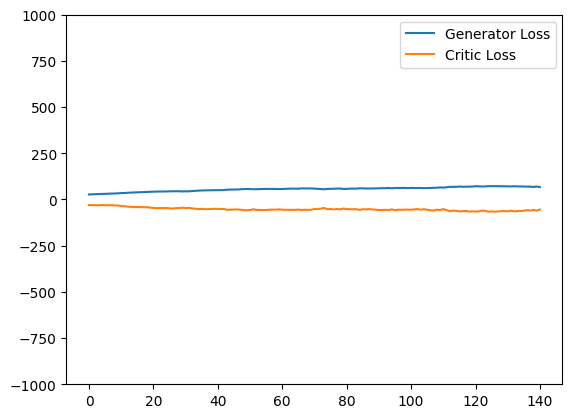

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  175 35
Saved checkpoint


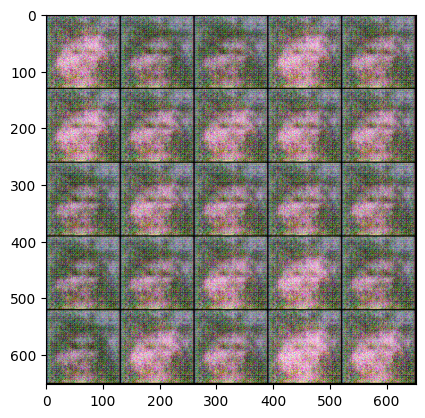

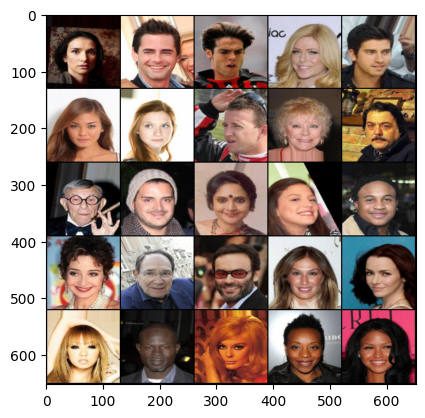

Epoch: 2: Step 175: Generator loss: 67.96722303118024, critic loss: -56.98284096854074


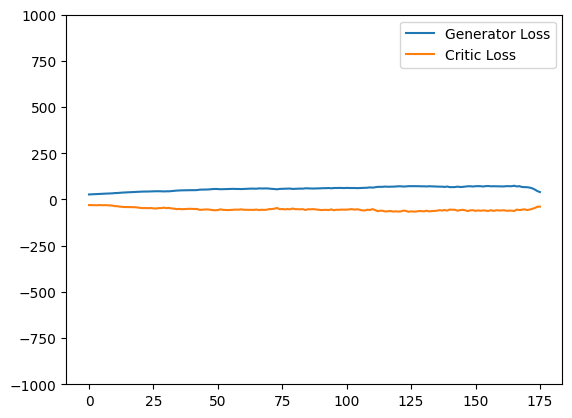

Saving checkpoin:  210 35
Saved checkpoint


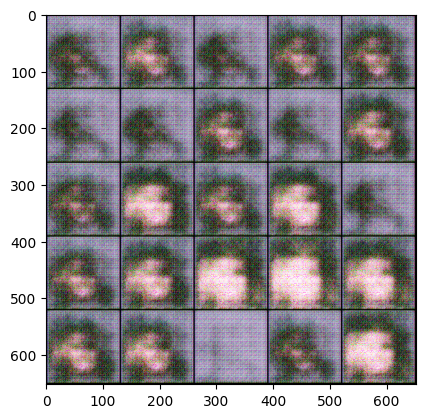

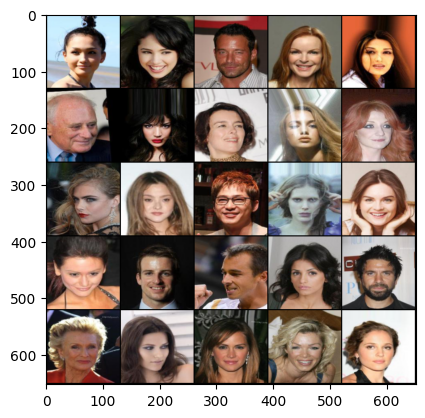

Epoch: 2: Step 210: Generator loss: 17.044268553597586, critic loss: -24.86424907684326


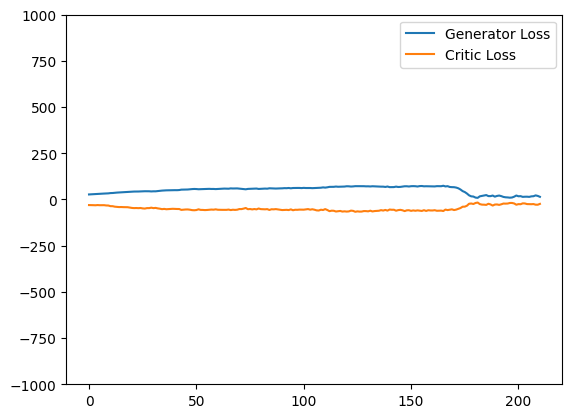

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  245 35
Saved checkpoint


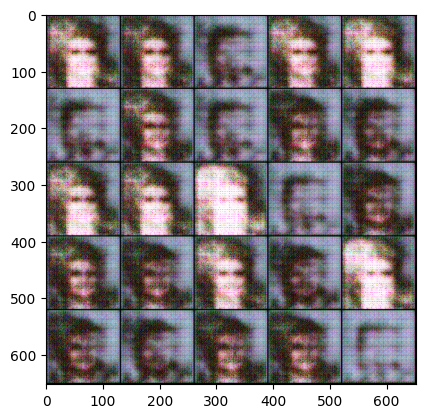

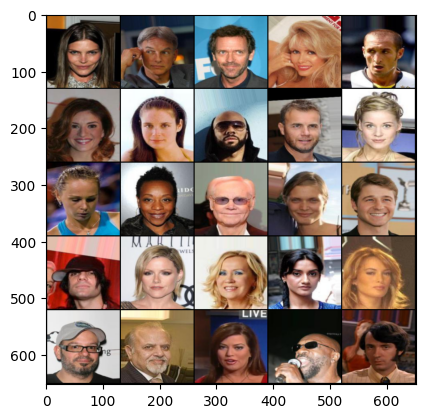

Epoch: 3: Step 245: Generator loss: 13.53960016795567, critic loss: -25.023899895804266


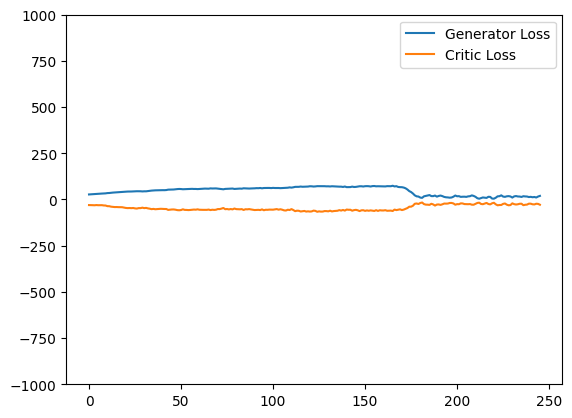

Saving checkpoin:  280 35
Saved checkpoint


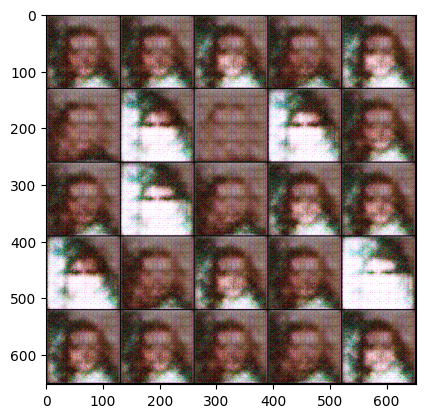

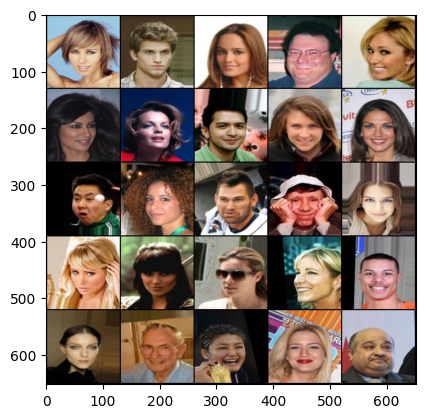

Epoch: 3: Step 280: Generator loss: 15.365140751429967, critic loss: -26.44154483522687


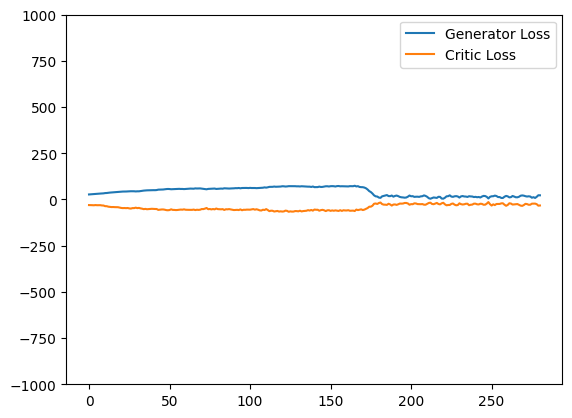

Saving checkpoin:  315 35
Saved checkpoint


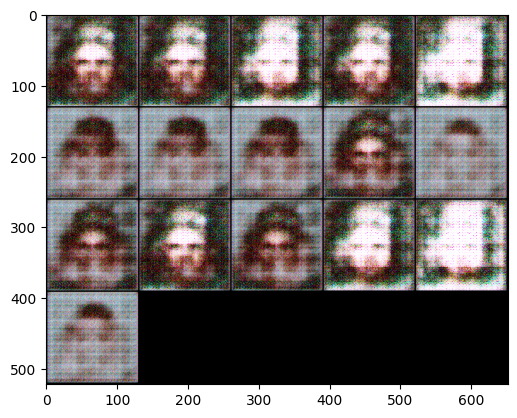

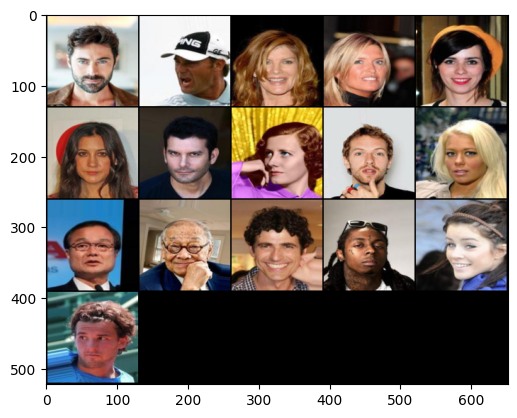

Epoch: 3: Step 315: Generator loss: 15.60687792641776, critic loss: -26.072353150503982


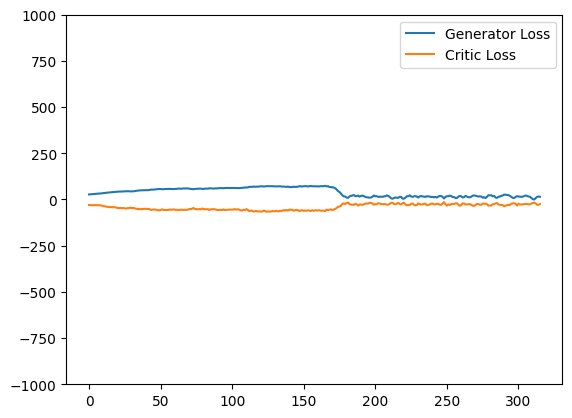

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  350 35
Saved checkpoint


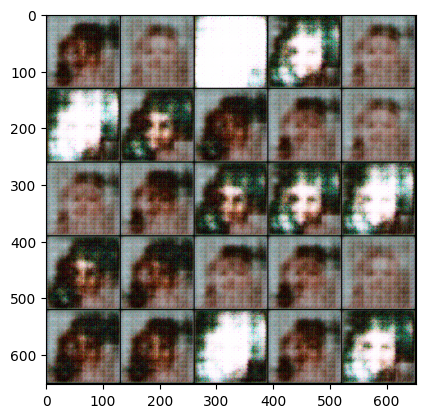

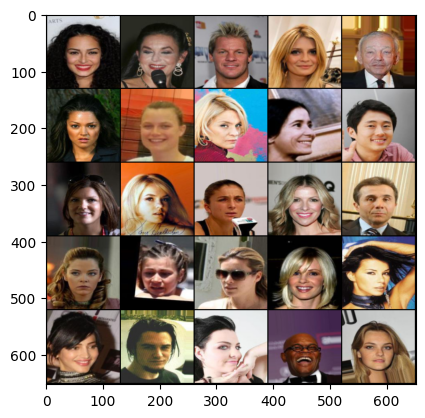

Epoch: 4: Step 350: Generator loss: 18.681422655923026, critic loss: -26.986174512590683


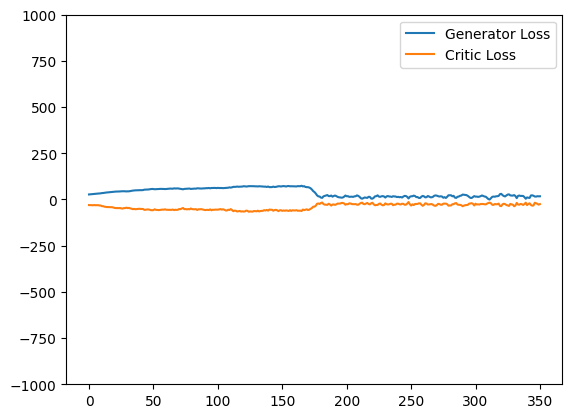

Saving checkpoin:  385 35
Saved checkpoint


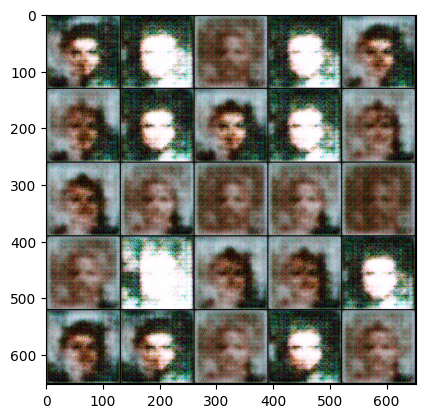

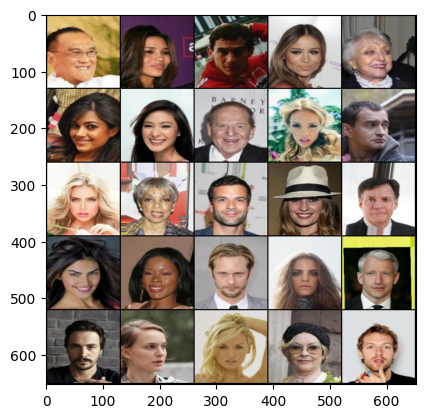

Epoch: 4: Step 385: Generator loss: 16.401142174857004, critic loss: -24.579044778006416


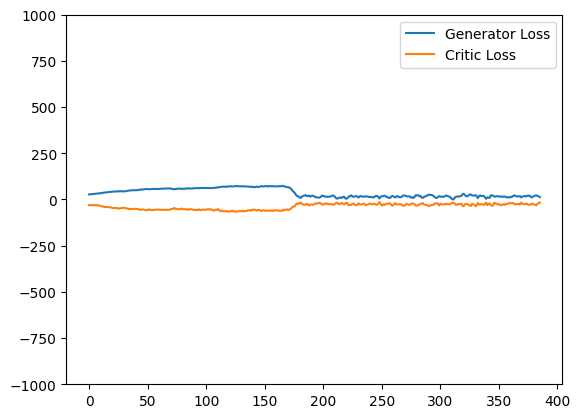

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  420 35
Saved checkpoint


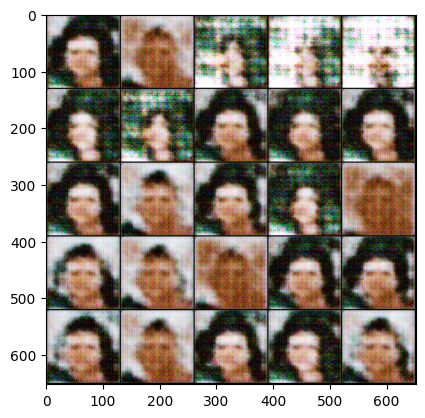

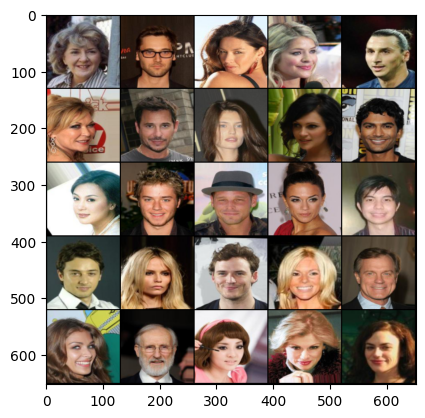

Epoch: 5: Step 420: Generator loss: 14.752622767857142, critic loss: -21.362645977565226


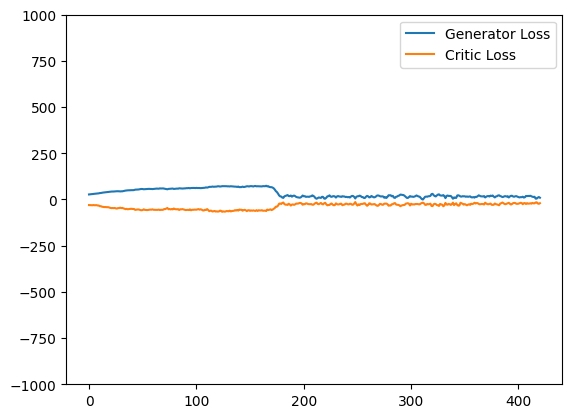

Saving checkpoin:  455 35
Saved checkpoint


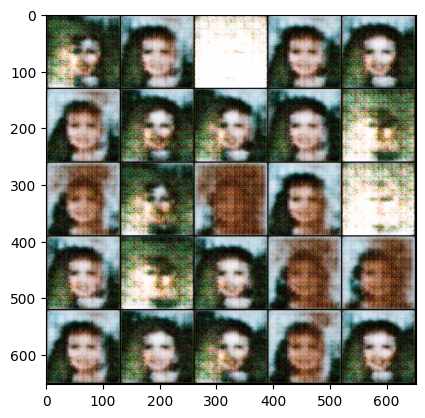

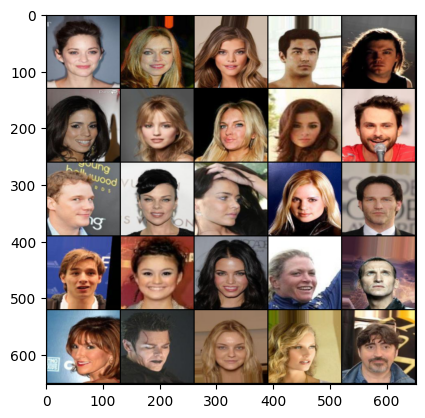

Epoch: 5: Step 455: Generator loss: 16.279685824257985, critic loss: -22.884610742841453


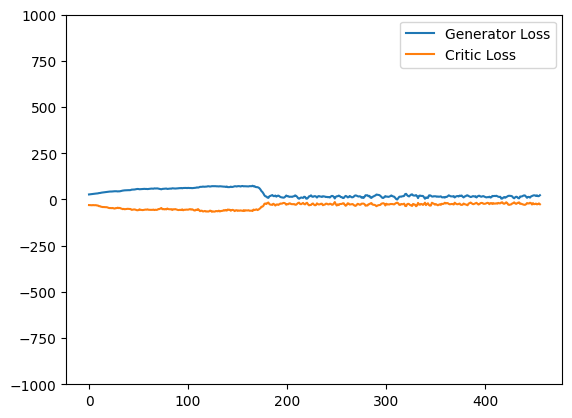

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  490 35
Saved checkpoint


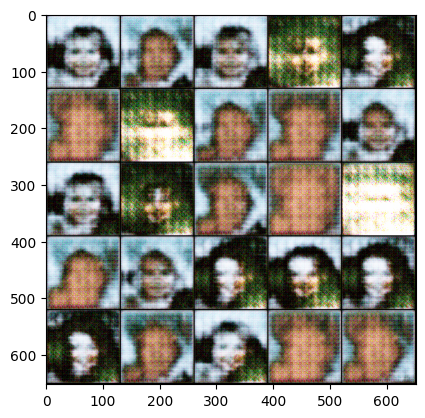

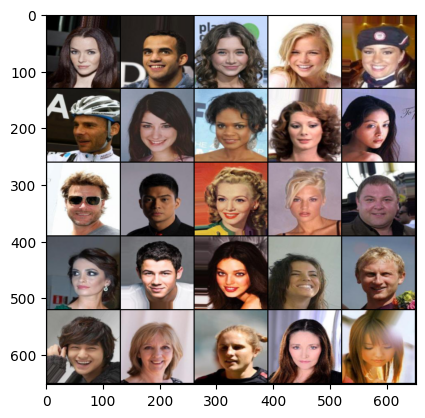

Epoch: 6: Step 490: Generator loss: 11.05368194920676, critic loss: -20.230613675798686


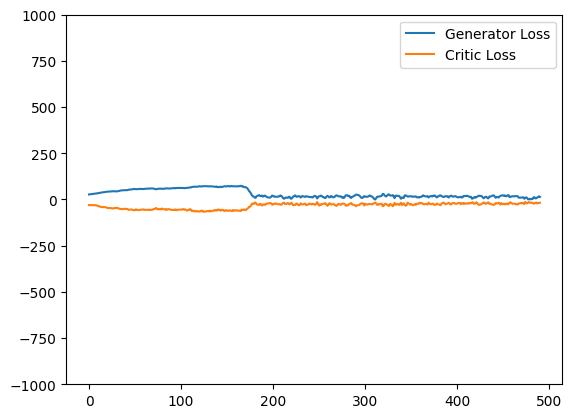

Saving checkpoin:  525 35
Saved checkpoint


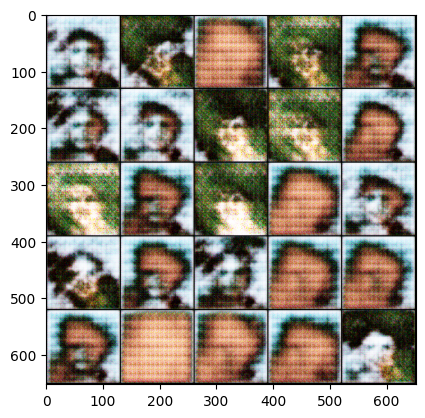

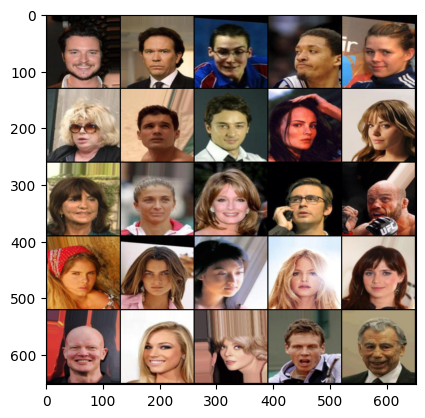

Epoch: 6: Step 525: Generator loss: 8.044640735217504, critic loss: -18.623582071576806


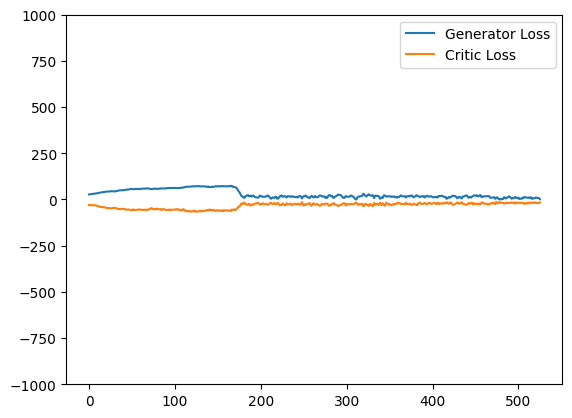

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  560 35
Saved checkpoint


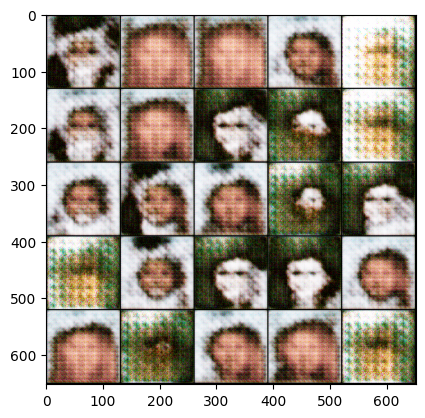

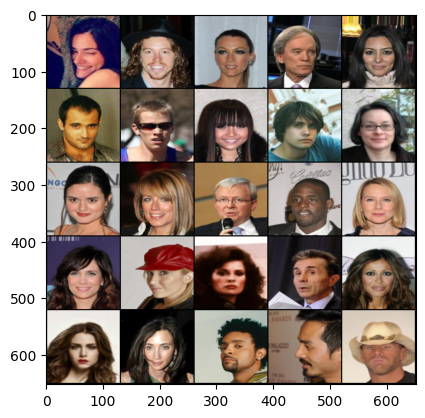

Epoch: 7: Step 560: Generator loss: 8.03216632945197, critic loss: -17.49595328739711


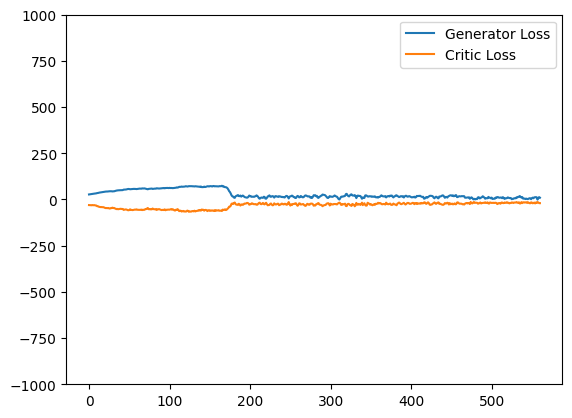

Saving checkpoin:  595 35
Saved checkpoint


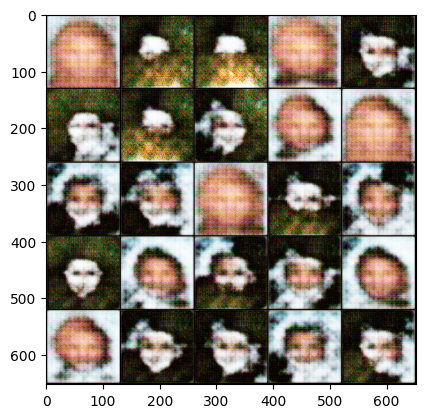

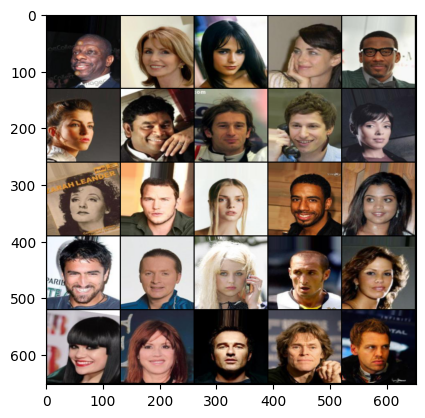

Epoch: 7: Step 595: Generator loss: 8.712173765046256, critic loss: -18.3061270904541


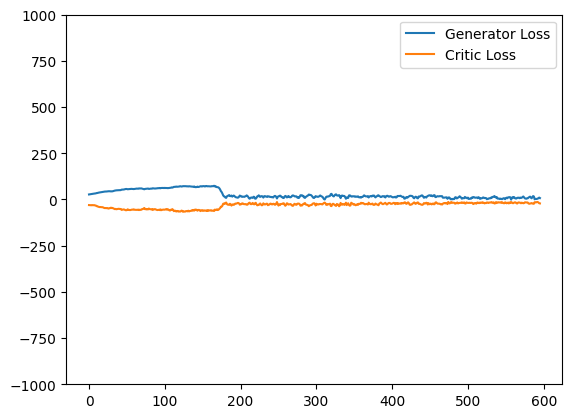

Saving checkpoin:  630 35
Saved checkpoint


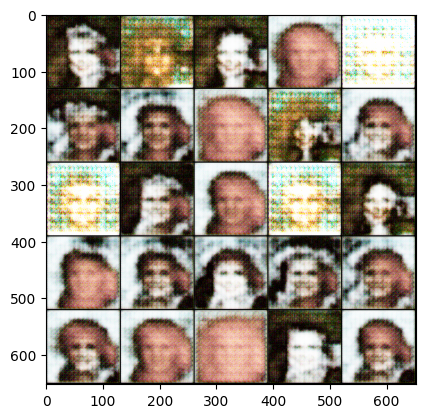

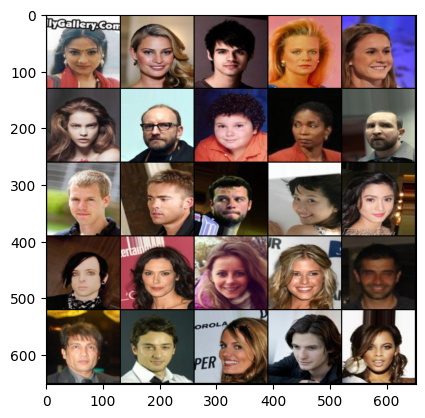

Epoch: 7: Step 630: Generator loss: 11.897720946584428, critic loss: -19.304676459176203


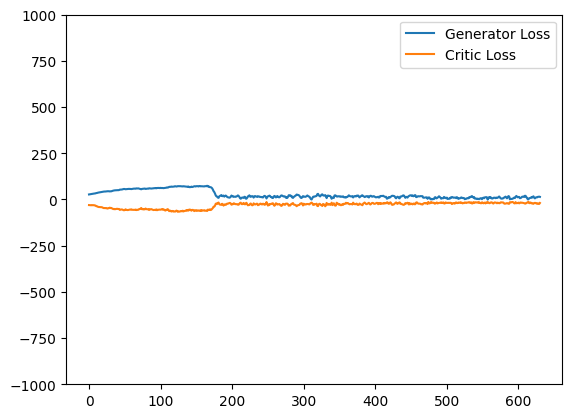

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  665 35
Saved checkpoint


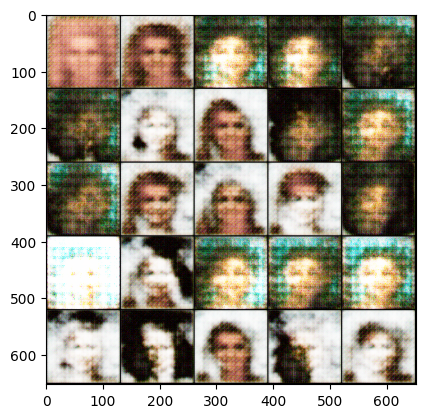

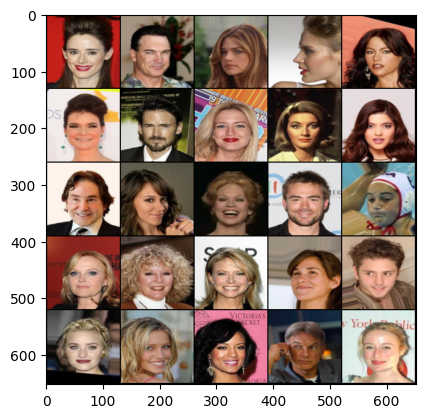

Epoch: 8: Step 665: Generator loss: 13.021474296706064, critic loss: -18.943387998853414


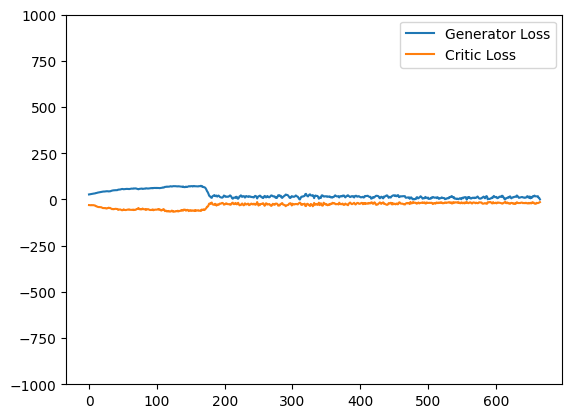

Saving checkpoin:  700 35
Saved checkpoint


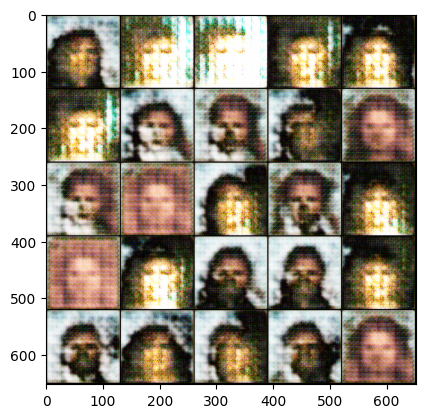

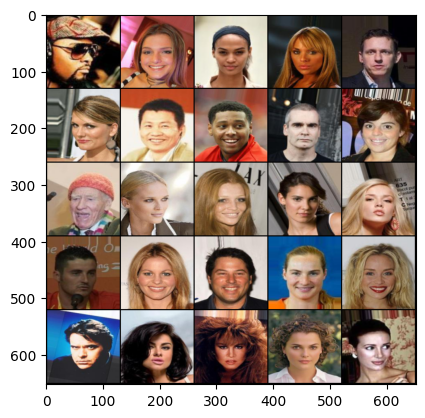

Epoch: 8: Step 700: Generator loss: 10.953179168701173, critic loss: -17.924622988019674


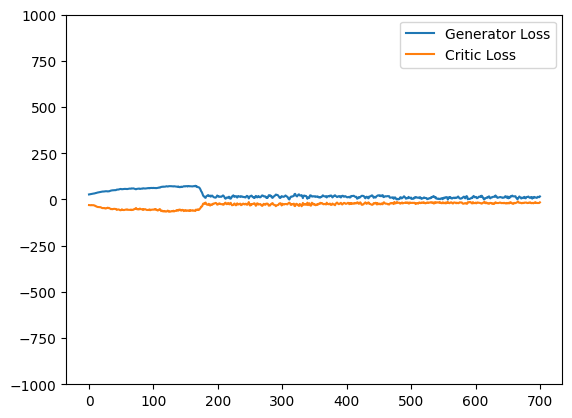

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  735 35
Saved checkpoint


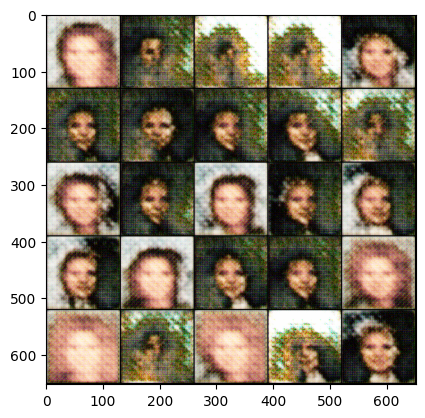

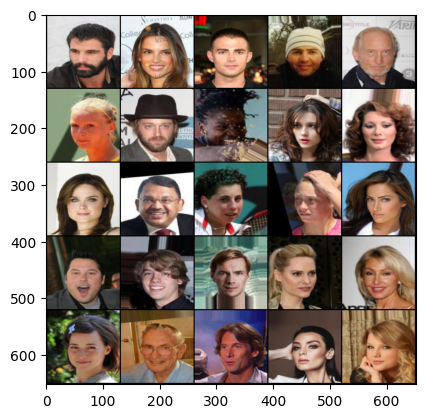

Epoch: 9: Step 735: Generator loss: 9.974875235131808, critic loss: -17.547465150015697


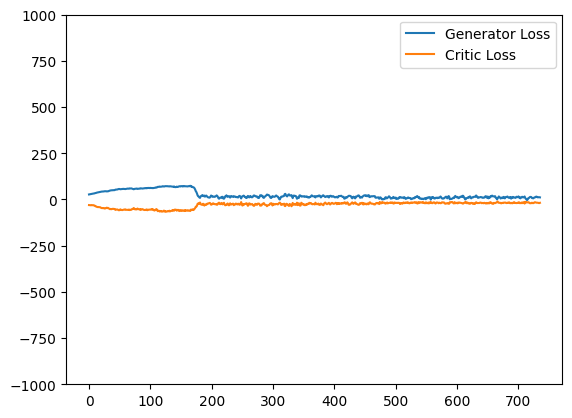

Saving checkpoin:  770 35
Saved checkpoint


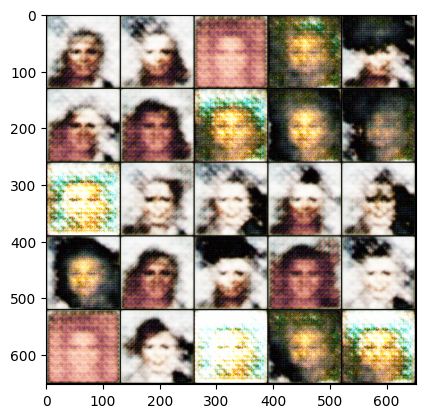

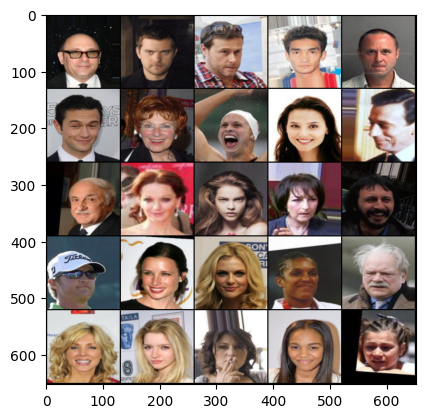

Epoch: 9: Step 770: Generator loss: 10.308822471754892, critic loss: -17.159867172241213


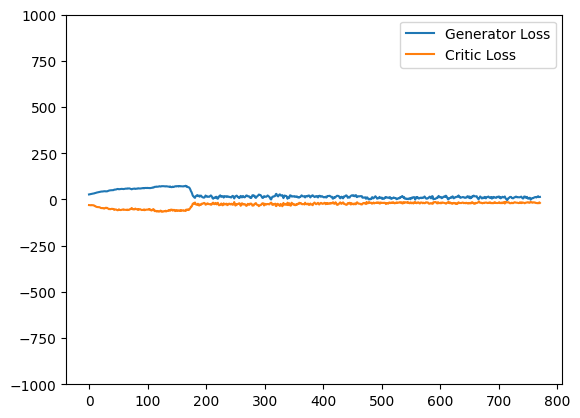

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  805 35
Saved checkpoint


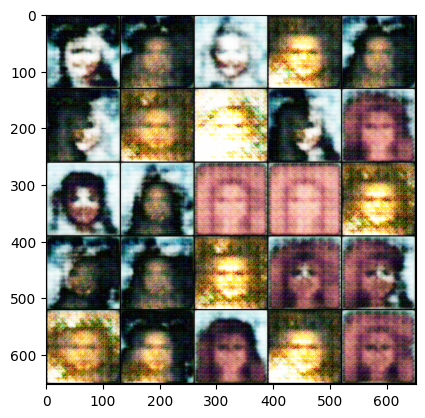

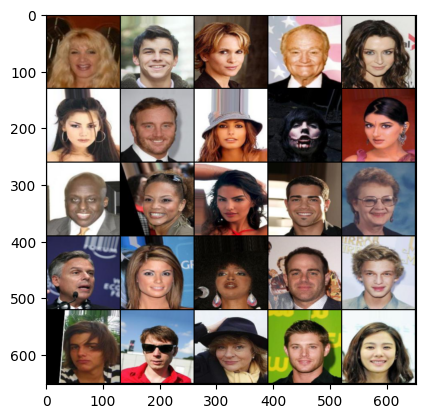

Epoch: 10: Step 805: Generator loss: 10.221838433401926, critic loss: -16.407770418439597


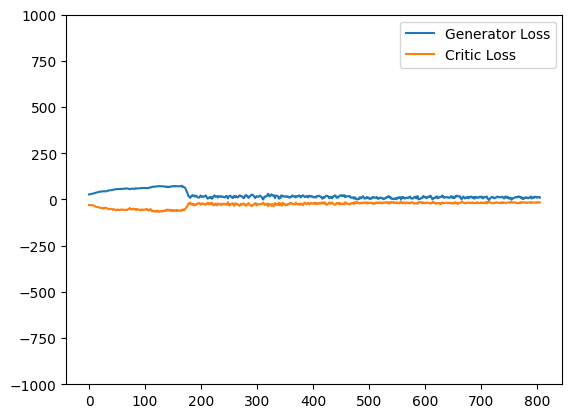

Saving checkpoin:  840 35
Saved checkpoint


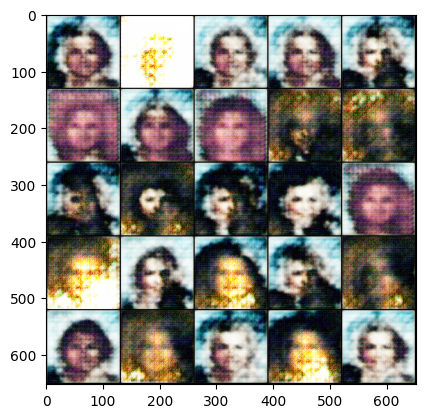

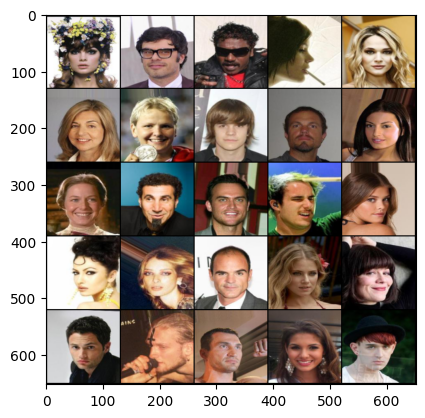

Epoch: 10: Step 840: Generator loss: 10.960750770568847, critic loss: -16.75281006949288


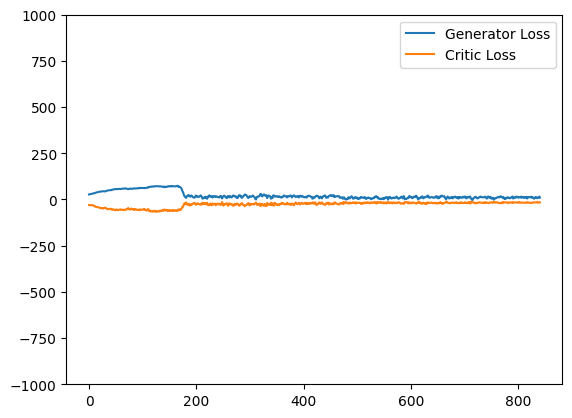

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  875 35
Saved checkpoint


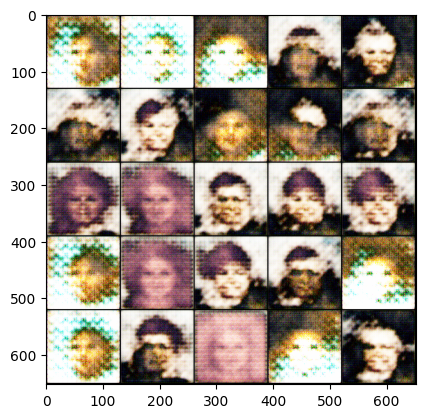

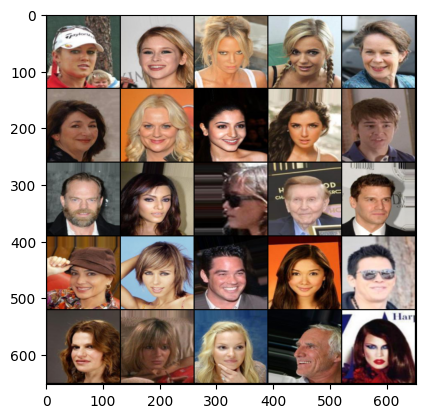

Epoch: 11: Step 875: Generator loss: 10.628033801487513, critic loss: -16.955510379246302


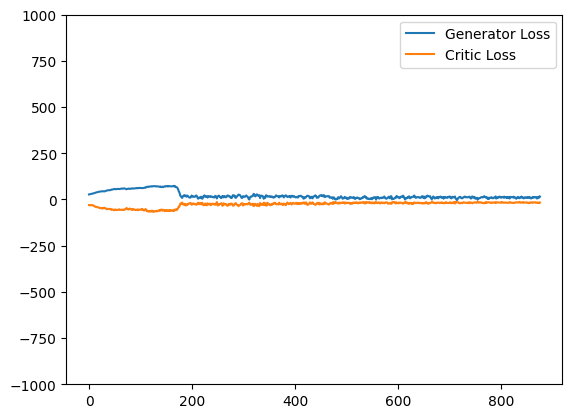

Saving checkpoin:  910 35
Saved checkpoint


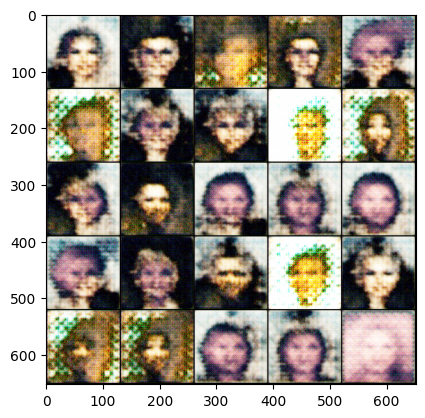

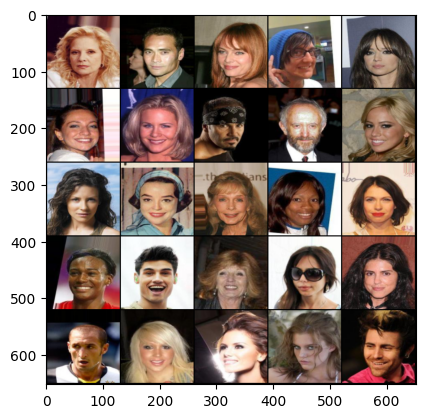

Epoch: 11: Step 910: Generator loss: 14.710313061305454, critic loss: -17.112177118573868


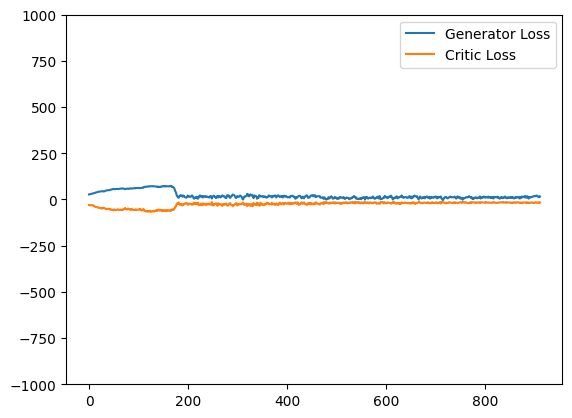

Saving checkpoin:  945 35
Saved checkpoint


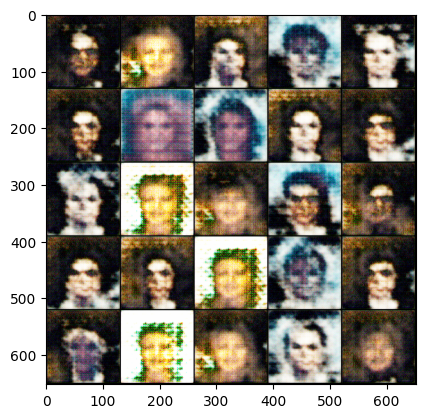

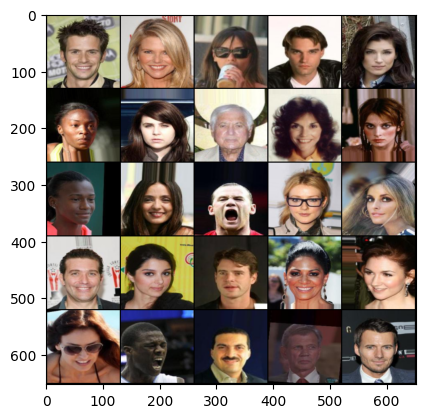

Epoch: 11: Step 945: Generator loss: 13.714998081752233, critic loss: -16.250728127615787


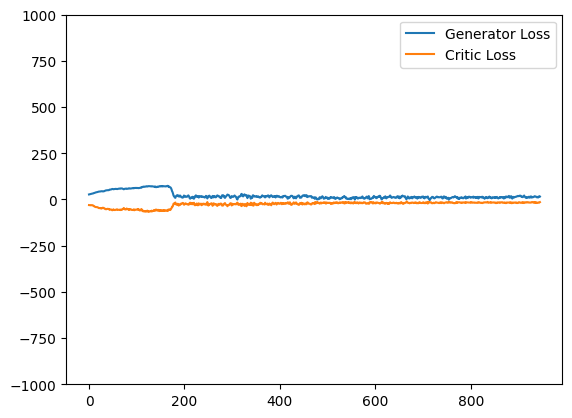

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoin:  980 35
Saved checkpoint


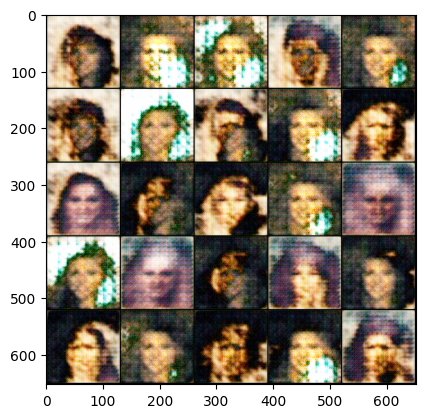

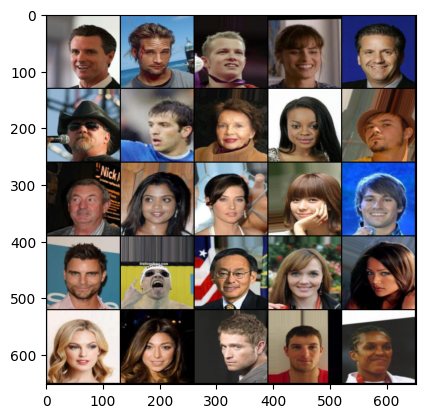

Epoch: 12: Step 980: Generator loss: 13.254202488490513, critic loss: -15.540994420732773


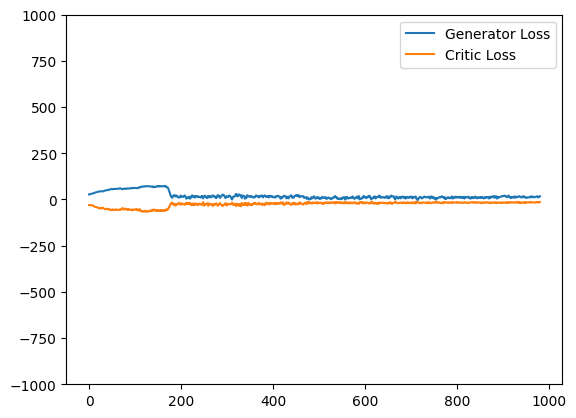

Saving checkpoin:  1015 35
Saved checkpoint


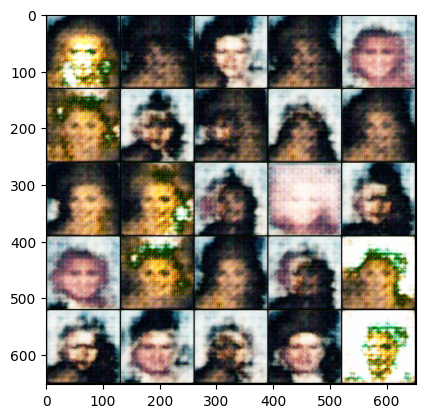

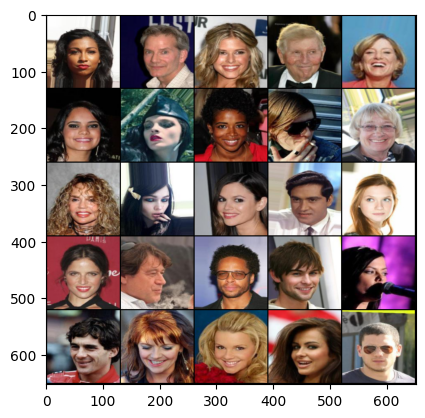

Epoch: 12: Step 1015: Generator loss: 14.589068576267787, critic loss: -15.727289641244068


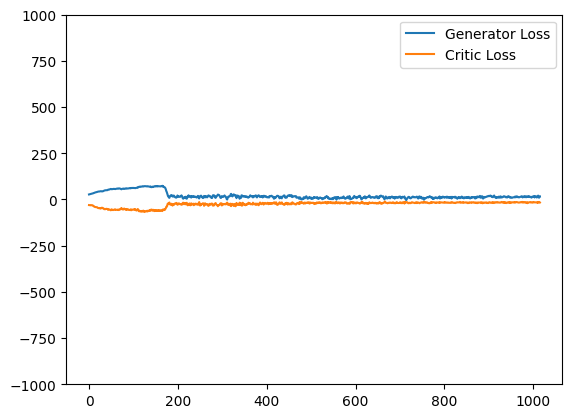

In [ ]:
## Training loop

for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs = len(real) # 128
    real = real.to(device)

    ### CRITIC
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise=gen_noise(cur_bs, z_dim)
      fake=gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha = torch.rand(len(real),1,1,1, device=device, requires_grad=True) # 128 x 1 x 1 x 1
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss += crit_loss.item() / crit_cycles

      crit_loss.backward(retain_graph=True)
      crit_opt.step()

    crit_losses+=[mean_crit_loss]

    ## GENERATOR
    gen_opt.zero_grad()
    noise=gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)

    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses+=[gen_loss.item()]

    ### Stats

    if(wandbact==1):
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss': mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print("Saving checkpoin: ", cur_step, save_step)
      save_checkpoint("latest")

    if (cur_step % show_step == 0 and cur_step > 0):
      show(fake, wanbactive=1, name='fake')
      show(real, wanbactive=1, name='real')

      gen_mean=sum(gen_losses[-show_step:])/ show_step
      crit_mean = sum(crit_losses[-show_step:])/ show_step
      print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label="Generator Loss",
      )

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(crit_losses),
          label="Critic Loss",
      )

      plt.ylim(-1000, 1000)
      plt.legend()
      plt.show()

    cur_step+=1

In [ ]:
### Generate new faces
### 
noise = gen_noise(batch_size, z_dim)
fake = gen(noise)

show(fake)

In [ ]:
### Get specific image
plt.imshow(fake[16].detach().cpu().permute(1,2,0).squeeze().clip(0,1))

In [ ]:
from mpl_toolkits.axes_grid1 import ImageGrid

# MORPHING, interpolation between points in latent space
gen_set=[]
z_shape=[1,200,1,1]
rows=4
steps=17

for i in range(rows):
  z1,z2 = torch.randn(z_shape), torch.randn(z_shape)
  for alpha in np.linspace(0,1,steps):
    z=alpha*z1 + (1-alpha)*z2
    res=gen(z.cuda())[0]
    gen_set.append(res)

fig = plt.figure(figsize=(25,11))
grid=ImageGrid(fig, 111, nrows_ncols=(rows,steps), axes_pad=0.1)

for ax , img in zip (grid, gen_set):
  ax.axis('off')
  res=img.cpu().detach().permute(1,2,0)
  res=res-res.min()
  res=res/(res.max()-res.min())
  ax.imshow(res.clip(0,1.0))

plt.show()